<a href="https://colab.research.google.com/github/arad1367/Deep_Learning_Project_Dog_vision1/blob/main/Deep_Learning_ANN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import os
import datetime

from IPython.display import Image
import matplotlib.image as mpimg
from matplotlib.pyplot import imread


from sklearn.model_selection import train_test_split

%config InlineBackend.figure_formats=['svg']

## 🐶 Using Transfer Learning and TensorFlow 2.0 to Classify Different Dog Breeds
Who's that doggy in the window?

Dogs are incredible. But have you ever been sitting at a cafe, seen a dog and not known what breed it is? I have. And then someone says, "it's an English Terrier" and you think, how did they know that?

In this project we're going to be using machine learning to help us identify different breeds of dogs.

To do this, we'll be using data from the Kaggle dog breed identification competition. It consists of a collection of 10,000+ labelled images of 120 different dog breeds.

This kind of problem is called multi-class image classification. It's multi-class because we're trying to classify mutliple different breeds of dog. If we were only trying to classify dogs versus cats, it would be called binary classification (one thing versus another).

Multi-class image classification is an important problem because it's the same kind of technology Tesla uses in their self-driving cars or Airbnb uses in atuomatically adding information to their listings.

Since the most important step in a deep learng problem is getting the data ready (turning it into numbers), that's what we're going to start with.

We're going to go through the following TensorFlow/Deep Learning workflow:

Get data ready (download from Kaggle, store, import).
Prepare the data (preprocessing, the 3 sets, X & y).
Choose and fit/train a model (TensorFlow Hub, tf.keras.applications, TensorBoard, EarlyStopping).
Evaluating a model (making predictions, comparing them with the ground truth labels).
Improve the model through experimentation (start with 1000 images, make sure it works, increase the number of images).
Save, sharing and reloading your model (once you're happy with the results).
For preprocessing our data, we're going to use TensorFlow 2.x. The whole premise here is to get our data into Tensors (arrays of numbers which can be run on GPUs) and then allow a machine learning model to find patterns between them.

For our machine learning model, we're going to be using a pretrained deep learning model from TensorFlow Hub.

The process of using a pretrained model and adapting it to your own problem is called transfer learning. We do this because rather than train our own model from scratch (could be timely and expensive), we leverage the patterns of another model which has been trained to classify images.

## 🐶 End-to-end Multil-class Dog Breed Classification
This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.x and TensorFlow Hub.

1. Problem
Identifying the breed of a dog given an image of a dog.

When I'm sitting at the cafe and I take a photo of a dog, I want to know what breed of dog it is.

2. Data
The data we're using is from Kaggle's dog breed identification competition.

https://www.kaggle.com/c/dog-breed-identification/data

3. Evaluation
The evaluation is a file with prediction probabilities for each dog breed of each test image.

https://www.kaggle.com/c/dog-breed-identification/overview/evaluation

4. Features
Some information about the data:

We're dealing with images (unstructured data) so it's probably best we use deep learning/transfer learning.
There are 120 breeds of dogs (this means there are 120 different classes).
There are around 10,000+ images in the training set (these images have labels).
There are around 10,000+ images in the test set (these images have no labels, because we'll want to predict them).


In [ ]:
# Unzip the uploaded data into Google Drive
# !unzip "drive/My Drive/Deep_Learning_Daniel/dog-breed-identification.zip" -d "drive/My Drive/Deep_Learning_Daniel/"

## Get our workspace ready
  * Import TensorFlow 2.x ✅
  * Import TensorFlow Hub ✅
  * Make sure we're using a GPU ✅

In [2]:
# Import necessary tools
import tensorflow as tf
import tensorflow_hub as hub
print ('tensorflow version is: ', tf.__version__)
print ('tensorflow_hub version is: ', hub.__version__)

# Check for GPU availability
physical_device = tf.config.list_physical_devices(device_type=('GPU'))
if physical_device:
  print('Yes, GPU is available!!!.')
else:
  print('GPU is Not available')

tensorflow version is:  2.9.2
tensorflow_hub version is:  0.12.0
Yes, GPU is available!!!.


## 1. Getting our data ready (turning into Tensors)
With all machine learning models, our data has to be in numerical format. So that's what we'll be doing first. Turning our images into Tensors (numerical representations).

Let's start by accessing our data and checking out the labels.

In [3]:
# Check out the labels of our data

labels_csv = pd.read_csv('/content/drive/MyDrive/Deep_Learning_Daniel/labels.csv')
print(labels_csv.describe())
print(labels_csv.head(5))

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [ ]:
labels_csv.shape, labels_csv.size, labels_csv.ndim, labels_csv.dtypes

((10222, 2), 20444, 2, id       object
 breed    object
 dtype: object)

In [ ]:
import random
 
# Generating a random number in between 0 and 2^24
color = random.randrange(0, 2**24)
 
# Converting that number from base-10 (decimal) to base-16 (hexadecimal)
hex_color = hex(color)
 
std_color = "#" + hex_color[2:]

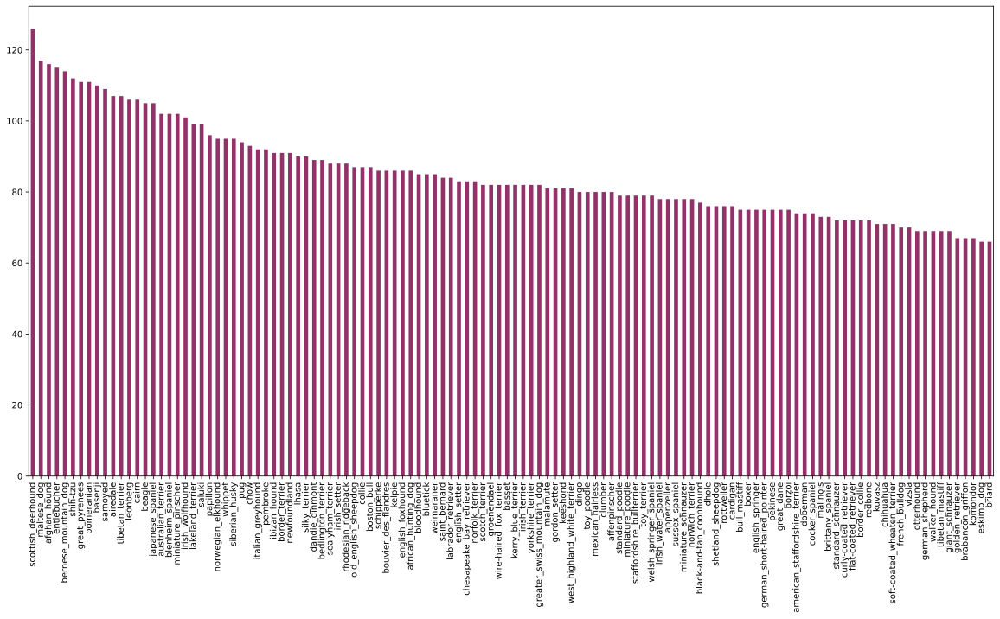

In [ ]:
# How many images are there of each breed? (value_counts)

labels_csv.breed.value_counts()  
labels_csv['breed'].value_counts().plot.bar(figsize=(20, 10), color=std_color);

In [ ]:
labels_csv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10222 entries, 0 to 10221
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      10222 non-null  object
 1   breed   10222 non-null  object
dtypes: object(2)
memory usage: 159.8+ KB


In [ ]:
labels_csv.breed.value_counts().median()

82.0

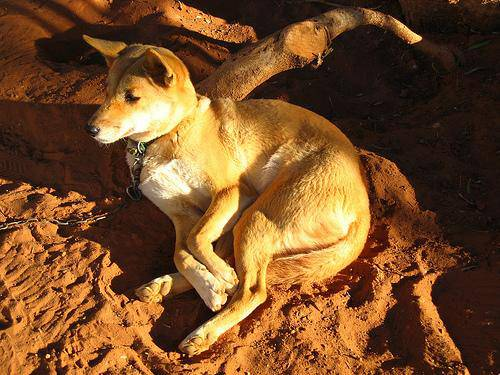

In [ ]:
# Let's view an image
from IPython.display import Image
image = Image(filename='/content/drive/MyDrive/Deep_Learning_Daniel/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg')
image

In [ ]:
# Another way to show an image in grid system 

img = mpimg.imread('/content/drive/MyDrive/Deep_Learning_Daniel/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg')
print(img)

[[[ 51  34  27]
  [ 55  38  30]
  [ 61  42  35]
  ...
  [128  92  60]
  [ 78  42  10]
  [168 132 100]]

 [[ 62  45  37]
  [ 64  45  38]
  [ 63  45  35]
  ...
  [115  81  53]
  [ 46  12   0]
  [ 73  39  11]]

 [[ 57  39  29]
  [ 58  38  29]
  [ 57  37  28]
  ...
  [ 60  33  12]
  [ 53  26   5]
  [ 63  36  15]]

 ...

 [[192 111  30]
  [185 103  30]
  [183 102  36]
  ...
  [ 52  26  29]
  [ 34   8   9]
  [ 21   0   0]]

 [[181 100  19]
  [202 120  47]
  [207 126  60]
  ...
  [ 35   6   8]
  [ 58  30  29]
  [ 88  60  57]]

 [[182 101  20]
  [205 123  50]
  [216 135  69]
  ...
  [ 38   9   5]
  [115  86  82]
  [192 163 157]]]


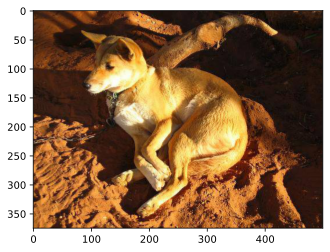

In [ ]:
imgplot = plt.imshow(img)

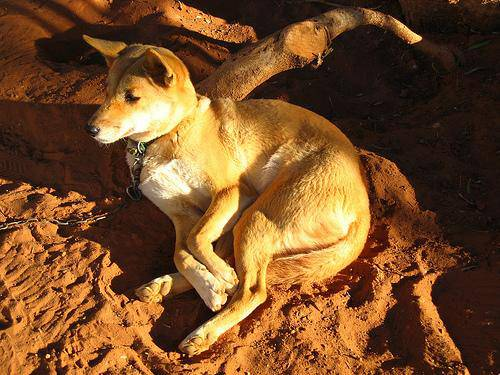

In [ ]:
image

### Getting images and their labels
Let's get a list of all of our image file pathnames.

In [ ]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
boston_bull = labels_csv[labels_csv.breed == 'boston_bull']
boston_bull

boston_bull_id = [idNumber for idNumber in boston_bull.id]
boston_bull_id

['000bec180eb18c7604dcecc8fe0dba07',
 '010d65bd29d246aea53d9849da142ccf',
 '0755a940eac9a9b8cf0328b4be062096',
 '07d7cfbdbd3682cae50902b53c798028',
 '0b3d3120a62c2bc280f589d473041d06',
 '10730dfd280bb4b2723dc677378f2ff1',
 '118060ca946af5cfd1b3bbe030f9003c',
 '13f939b9b15ec56409a21017263db93c',
 '146be641443a270dd8116f65d53d0c9d',
 '16aaa590e39530bc1cb319fc7d89c00e',
 '172fcb0b8bbd67401c9e53e5f9bf39bc',
 '20be3ce1dd7db9194c856726c2f154a3',
 '240ce7dee9610547cad87c92fcff7dbb',
 '251c34f3b527215f0b865a4580bf4e95',
 '2c5f6c1c3acef3e307fd92378caf198c',
 '2cddd21e49ea9246eaa8012ae03aedac',
 '2de8d47770da0fb805ccf8461d062c54',
 '2fde20eb9c645c02a583ef01ebce6374',
 '309bf67309851334acebe0003c21b180',
 '30c2c1c75e271b8baae54908bfd8e98a',
 '30ff784cea2bfc2a6df330f58e781b98',
 '33a255a956f02a591865dbe9768eff77',
 '346c9842d580b40bd7ca52d4095e3ea4',
 '36549cf287a833afff09821e55a923d8',
 '387ae89153da8b0171322ab0cd54923e',
 '3c4a342c6aca01e2a31c03b072916fbe',
 '44e59225be92c4cecb96acc669962242',
 

In [4]:
# Create pathname from image's ID

filenames = ['/content/drive/MyDrive/Deep_Learning_Daniel/train/'+ fileName +'.jpg' for fileName in labels_csv.id]

In [ ]:
filenames[:7]

['/content/drive/MyDrive/Deep_Learning_Daniel/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/00290d3e1fdd27226ba27a8ce248ce85.jpg']

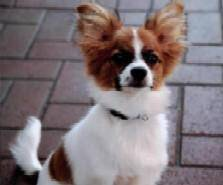

In [ ]:
# import one image from filenames_train

random_image = Image(random.choice(filenames))
random_image

In [5]:
# Check whether number of filenames matches number of actual image files

import os
if len(os.listdir("/content/drive/MyDrive/Deep_Learning_Daniel/train/")) == len(filenames):
  print("Filenames match actual amount of files!!! Proceed.")
else:
  print("Filenames do no match actual amount of files, check the target directory.")

Filenames match actual amount of files!!! Proceed.


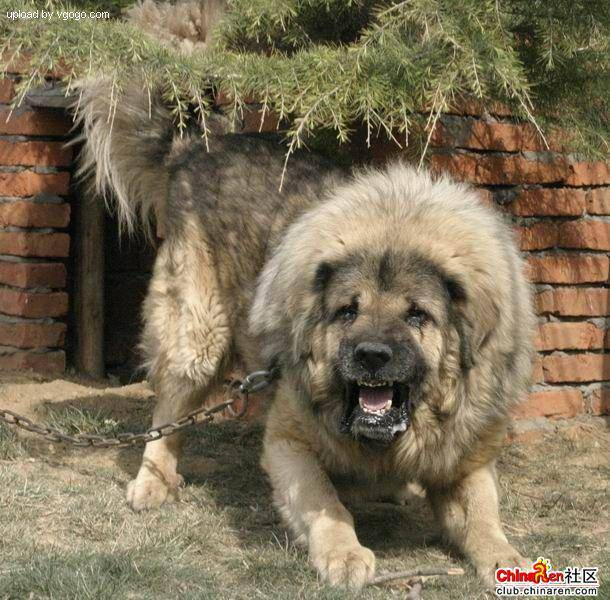

In [ ]:
# One more check
Image(filenames[9000])

In [ ]:
labels_csv.breed[9000]

'tibetan_mastiff'

## Tuning data labels to numbers

In [ ]:
labels_csv['filenames'] = filenames

In [ ]:
labels_csv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10222 entries, 0 to 10221
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   id         10222 non-null  object
 1   breed      10222 non-null  object
 2   filenames  10222 non-null  object
dtypes: object(3)
memory usage: 239.7+ KB


In [ ]:
labels_csv.head().T

,0,1,2,3,4
id,000bec180eb18c7604dcecc8fe0dba07,001513dfcb2ffafc82cccf4d8bbaba97,001cdf01b096e06d78e9e5112d419397,00214f311d5d2247d5dfe4fe24b2303d,0021f9ceb3235effd7fcde7f7538ed62
breed,boston_bull,dingo,pekinese,bluetick,golden_retriever
filenames,/content/drive/MyDrive/Deep_Learning_Daniel/tr...,/content/drive/MyDrive/Deep_Learning_Daniel/tr...,/content/drive/MyDrive/Deep_Learning_Daniel/tr...,/content/drive/MyDrive/Deep_Learning_Daniel/tr...,/content/drive/MyDrive/Deep_Learning_Daniel/tr...


In [ ]:
labels_csv.breed.dtype

dtype('O')

In [ ]:
labels_csv.id[100], labels_csv.filenames[100]

('025d903b457b865fd29424916e42fbc2',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/025d903b457b865fd29424916e42fbc2.jpg')

In [ ]:
labels_csv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10222 entries, 0 to 10221
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   id         10222 non-null  object
 1   breed      10222 non-null  object
 2   filenames  10222 non-null  object
dtypes: object(3)
memory usage: 239.7+ KB


Since we've now got our training image filepaths in a list, let's prepare our labels.

In [6]:
labels = labels_csv.breed
# labels = labels_csv["breed"].to_numpy() 
labels = np.array(labels)
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
len(labels)

10222

In [ ]:
# See if number of labels matches the number of filenames
if len(labels) == len(filenames):
  print("Number of `labels array` matches number of filenames `string list`!")
else:
  print("Number of labels does not match number of filenames, check data directories!")

Number of `labels array` matches number of filenames `string list`!


In [7]:
# Find the unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [ ]:
# Turn a single label into an array of booleans
print(labels[10])
labels[10] == unique_breeds

shetland_sheepdog


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
        True, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [9]:
# Turn every label into a boolean array
boolean_labels = [label==unique_breeds for label in labels]
boolean_labels[:3]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
len(boolean_labels), len(labels)

(10222, 10222)

In [ ]:
# Example: Turning boolean array into integers
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])[0][0]) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs

boston_bull
19
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [ ]:
print(labels[2])
print(boolean_labels[2].astype(int))
print(type(labels))

pekinese
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]
<class 'numpy.ndarray'>


In [ ]:
filenames[:10]

['/content/drive/MyDrive/Deep_Learning_Daniel/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
boolean_labels_to_numbers = np.array(boolean_labels).astype(int)

In [ ]:
boolean_labels_to_numbers

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [ ]:
boolean_labels_to_numbers[:2]

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0]])

## Now our labels are in int format(numpy array int) and our filenames is a list of string)

# -----------------------------

## Creating our own validation set
Since the dataset from Kaggle doesn't come with a validation set (a split of the data we can test our model on before making final predicitons on the test set), let's make one.

We could use Scikit-Learn's train_test_split function or we could simply make manual splits of the data.

For accessibility later, let's save our filenames variable to x (data) and our labels to y.

In [10]:
# Setup x and y variables
x = filenames  # list
y = boolean_labels  # array

In [ ]:
x[:5]

['/content/drive/MyDrive/Deep_Learning_Daniel/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/train/0021f9ceb3235effd7fcde7f7538ed62.jpg']

In [ ]:
y[:3]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
len(x) == len(y), len(x), len(y)

(True, 10222, 10222)

### Since we're working with 10,000+ images, it's a good idea to work with a portion of them to make sure things are working before training on them all.

This is because computing with 10,000+ images could take a fairly long time. And our goal when working through machine learning projects is to reduce the time between experiments.

Let's start experimenting with 1000 and increase it as we need.

In [11]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [ ]:
# Make train, valid, test manually (just for example)
import math
np.random.seed(42)

df = pd.DataFrame(data=np.random.randn(1000, 4), columns=['C1', 'C2', 'C3', 'C4'])
df.head()
len(df)

df.sample(frac=1)

x_total = df.drop('C4', axis=1)
y_total = df['C4']

train_bond = math.ceil(len(df) * 0.7)
valid_bond = math.ceil(train_bond + 0.15*len(df))
print(train_bond)
print(valid_bond)

x_train, y_train = x_total[:train_bond], y_total[:train_bond]
x_valid, y_valid = x_total[train_bond:valid_bond], y_total[train_bond:valid_bond]
x_test, y_test = x_total[valid_bond:], y_total[valid_bond:]

len(labels_csv), len(x_train), len(y_train), len(x_valid), len(y_valid), len(x_test), len(y_test)

700
850


(10222, 700, 700, 150, 150, 150, 150)

In [12]:
# Import train_test_split from Scikit-Learn
from sklearn.model_selection import train_test_split

# np.random.seed(42) / we used random_state instead of this random seed

# Split them into training and validation using NUM_IMAGES 
x_train, x_val, y_train, y_val = train_test_split(x[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(x_train), len(y_train), len(x_val), len(y_val)

(800, 800, 200, 200)

In [ ]:
# Let's have a geez at the training data
# Again remember filename is list and labels (y) is array till now!!
x_train[:5], y_train[:2]

(['/content/drive/MyDrive/Deep_Learning_Daniel/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/MyDrive/Deep_Learning_Daniel/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  '/content/drive/MyDrive/Deep_Learning_Daniel/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  '/content/drive/MyDrive/Deep_Learning_Daniel/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  '/content/drive/MyDrive/Deep_Learning_Daniel/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False

### Preprocessing images (turning images into Tensors)
Our labels are in numeric format but our images are still just file paths.

Since we're using TensorFlow, our data has to be in the form of Tensors.

A Tensor is a way to represent information in numbers. If you're familar with NumPy arrays (you should be), a Tensor can be thought of as a combination of NumPy arrays, except with the special ability to be used on a GPU.

Because of how TensorFlow stores information (in Tensors), it allows machine learning and deep learning models to be run on GPUs (generally faster at numerical computing).

To preprocess our images into Tensors we're going to write a function which does a few things:

1. `Takes an image filename as input.`
2. `Uses TensorFlow to read the file and save it to a variable, image.`
3. `Turn our image (a jpeg file) into Tensors.`
4. `Resize the image to be of shape (224, 224).
Return the modified image.`

A good place to read about this type of function is the TensorFlow documentation on loading images.

You might be wondering why (224, 224), which is (heigh, width). It's because this is the size of input our model (we'll see this soon) takes, an image which is (224, 224, 3).

What? Where's the 3 from? We're getting ahead of ourselves but that's the number of colour channels per pixel, red, green and blue.

Let's make this a little more concrete.

In [13]:
# Convert image to NumPy array
from matplotlib.pyplot import imread
image = imread(filenames[42])
image.shape

(257, 350, 3)

In [ ]:
# every image has a value between 0 to 255
image

array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]],

       [[ 56, 104,  66],
        [ 58, 106,  66],
        [ 64, 112,  72],
        ...,
        [ 71, 127,  82],
        [ 73, 129,  84],
        [ 73, 130,  85]],

       ...,

       [[  2,  11,  10],
        [  5,  14,  13],
        [  6,  15,  14],
        ...,
        [120, 113,  67],
        [126, 118,  72],
        [122, 114,  67]],

       [[  0,   4,   6],
        [  0,   9,   8],
        [  1,  10,   9],
        ...,
        [105,  98,  52],
        [111, 104,  58],
        [111, 103,  56]],

       [[ 18,  16,  37],
        [ 18,  18,  28],
        [ 17,  20,  11],
        ...,
        [101,  92,  53],
        [ 97,  88,  49],
        [120, 111,  72]]

In [ ]:
image.max(), image.min()

(255, 0)

In [ ]:
image[:2].shape

(2, 350, 3)

In [ ]:
# Turn image into a tensor
tf.constant(image[:2])

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

Now we've seen what an image looks like as a Tensor, let's make a function to preprocess them.

We'll create a function to:

Take an image filepath as input
Use TensorFlow to read the file and save it to a variable, image
Turn our image (a jpg) into Tensors
Normalize our image (convert color channel values from from 0-255 to 0-1).
Resize the image to be a shape of (224, 224)
Return the modified image
More information on loading images in TensorFlow can be seen here: https://www.tensorflow.org/tutorials/load_data/images

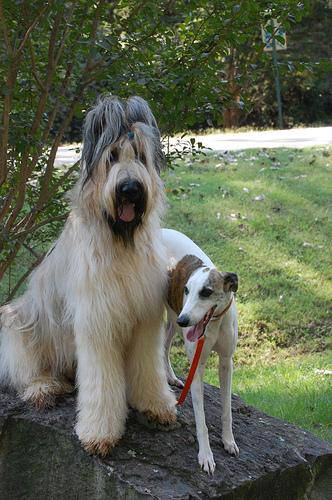

In [ ]:
# Just as a note, if we want to read names of all images from specific folder
import os
filename_os = os.listdir("/content/drive/MyDrive/Deep_Learning_Daniel/train")
filename_os[:5], type(filename_os)
filename_os_str = ['/content/drive/MyDrive/Deep_Learning_Daniel/train/'+fileName for fileName in filename_os]
filename_os_str[:4]
Image(filename=filename_os_str[3])

In [14]:
# Define image size
IMG_SIZE = 224

# Create a function for preprocessing images
def process_image(image_path, img_size=IMG_SIZE):
  """
  Takes an image file path and turns the image into a Tensor.
  """
  # Read in an image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-255 to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image

### Turning data to batches
Wonderful. Now we've got a function to convert our images into Tensors, we'll now build one to turn our data into batches (more specifically, a TensorFlow BatchDataset).

`What's a batch?`

A batch (also called mini-batch) is a small portion of your data, say 32 (32 is generally the default batch size) images and their labels. In deep learning, instead of finding patterns in an entire dataset at the same time, you often find them one batch at a time.

Let's say you're dealing with 10,000+ images (which we are). Together, these files may take up more memory than your GPU has. Trying to compute on them all would result in an error.

Instead, it's more efficient to create smaller batches of your data and compute on one batch at a time.

TensorFlow is very efficient when your data is in batches of (image, label) Tensors. So we'll build a function to do create those first. We'll take advantage of of process_image function at the same time.

In order to use TensorFlow effectively, we need our data in the form of Tensor tuples which look like this: `(image, label)`.

In [17]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label(not tensors in this stage),
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label

In [ ]:
# Demo of the above
(process_image(x[42]), tf.constant(y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117759],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now we've got a simple function to turn our image file path names and their associated labels into tuples (we can turn these into Tensors next), we'll create a function to make data batches.

Because we'll be dealing with 3 different sets of data (training, validation and test), we'll make sure the function can accomodate for each set.

We'll set a default batch size of 32 because according to Yann Lecun (one of the OG's of deep learning), friends don't let friends train with batch sizes over 32.

In [18]:
# Define the batch size, 32 is a good start
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  
  # If the data is a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x),
                                               tf.constant(y)))
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples (this also turns the iamge path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the training data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [19]:
# Create training and validation data batches
train_data = create_data_batches(x_train, y_train)
val_data = create_data_batches(x_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [ ]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

Look at that! We've got our data in batches, more specifically, they're in Tensor pairs of (images, labels) ready for use on a GPU.

But having our data in batches can be a bit of a hard concept to understand. Let's build a function which helps us visualize what's going on under the hood.

## Visualizing data batches (must be based on batched data to show visual and iteration)

  `Our data is now in batches, however, these can be a little hard to understand/comprehend, let's visualize them!`

In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_9_images(images, labels):
  """
  Displays 9 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 9 (for displaying 9 images)
  for i in range(9):
    # Create subplots (3 rows, 3 columns)
    ax = plt.subplot(3, 3, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn gird lines off
    plt.axis("off")

  `To make computation efficient, a batch is a tighly wound collection of Tensors.

So to view data in a batch, we've got to unwind it.

We can do so by calling the `as_numpy_iterator()` method on a data batch.

This will turn our a data batch into something which can be iterated over.

Passing an iterable to next() will return the next item in the iterator.

In our case, next will return a batch of 32 images and label pairs.

Note: Running the cell below and loading images may take a little while.`

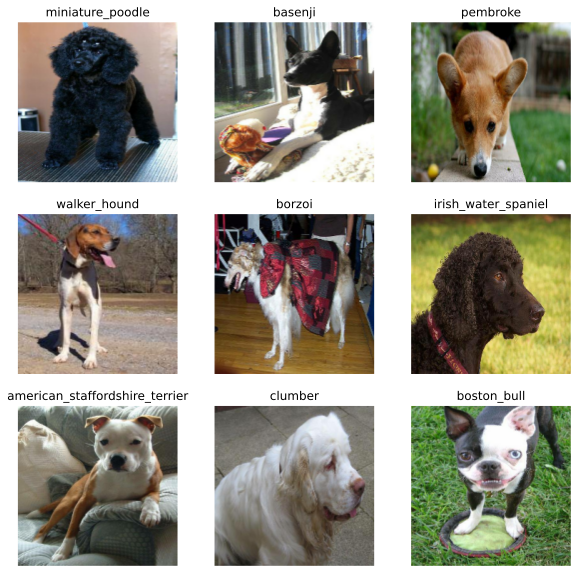

In [ ]:
# Visualize training images from the training data batch
train_images, train_labels = next(train_data.as_numpy_iterator())
# len(train_images) and len(train_labels) are 32 because of batch_size
show_9_images(train_images, train_labels)

CPU times: user 272 ms, sys: 22.5 ms, total: 295 ms
Wall time: 3.78 s


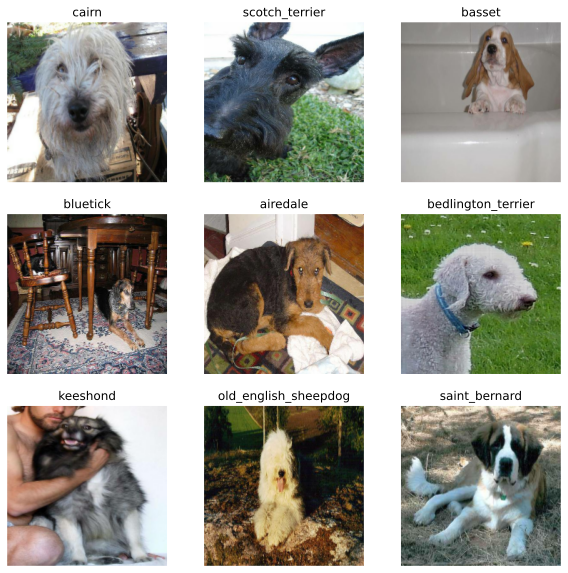

In [ ]:
%%time
# Visualize validation images from the validation data batch (unbatch format)
val_images, val_labels = next(val_data.as_numpy_iterator())
show_9_images(val_images, val_labels)

## **Creating and training a model**

`Now our data is ready, let's prepare it modelling. We'll use an existing model from TensorFlow Hub.`

TensorFlow Hub is a resource where you can find pretrained machine learning models for the problem you're working on.

Using a pretrained machine learning model is often referred to as transfer learning.

`Why use a pretrained model?`
Building a machine learning model and training it on lots from scratch can be expensive and time consuming.

Transfer learning helps eliviate some of these by taking what another model has learned and using that information with your own problem.

`How do we choose a model?`
Since we know our problem is image classification (classifying different dog breeds), we can navigate the TensorFlow Hub page by our problem domain (image).

We start by choosing the image problem domain, and then can filter it down by subdomains, in our case, image classification.

Doing this gives a list of different pretrained models we can apply to our task.

Clicking on one gives us information about the model as well as instructions for using it.

For example, clicking on the mobilenet_v2_130_224 model, tells us this model takes an input of images in the shape 224, 224. It also says the model has been trained in the domain of image classification.

Let's try it out.

Building a model
`Before we build a model, there are a few things we need to define:`

- `The input shape (images, in the form of Tensors) to our model.`
- `The output shape (image labels, in the form of Tensors) of our model.`
- `The URL of the model we want to use.`
These things will be standard practice with whatever machine learning model you use. And because we're using TensorFlow, everything will be in the form of Tensors.

In [20]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
# MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"
MODEL_URL = 'https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5'

Now we've got the inputs, outputs and model we're using ready to go. We can start to put them together

There are many ways of building a model in TensorFlow but one of the best ways to get started is to use the Keras API.
https://www.tensorflow.org/guide/keras/sequential_model 

Defining a deep learning model in Keras can be as straightforward as saying, "here are the layers of the model, the input shape and the output shape, let's go!"

Knowing this, let's create a function which:

- `Takes the input shape, output shape and the model we've chosen's URL as parameters.`
- `Defines the layers in a Keras model in a sequential fashion (do this first, then this, then that).`
- `Compiles the model (says how it should be evaluated and improved).`
- `Builds the model (tells it what kind of input shape it'll be getting).`
- `Returns the model.`
We'll take a look at the code first, then dicuss each part.

All of these steps can be found here: 
https://www.tensorflow.org/guide/keras/overview

In [21]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer), Softmax is used in mutli-class classification
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), # in multi-class classification
      optimizer=tf.keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # Build the model
  model.build(INPUT_SHAPE)

  return model

In [22]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


### Important information about model we have made.

- Model setup
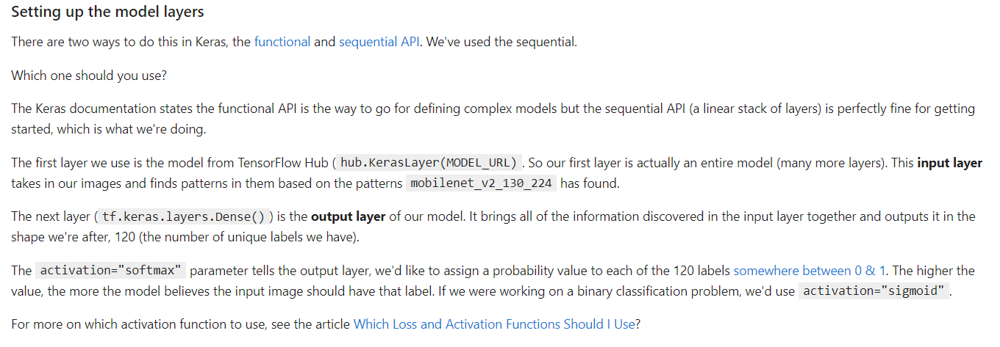

- Compile the model
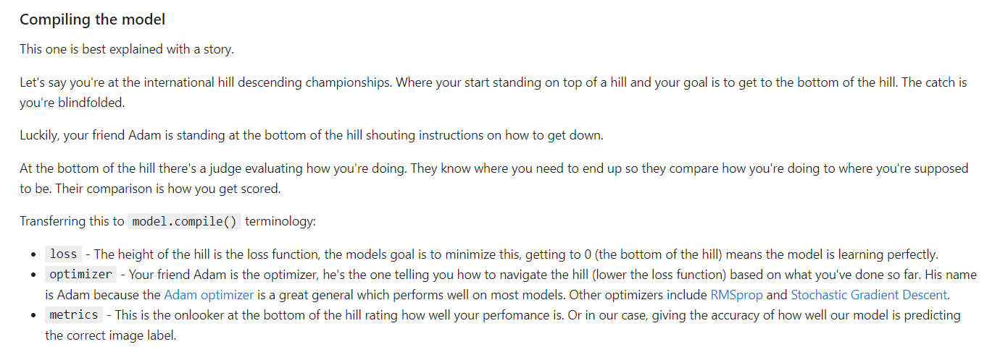

- Build the model
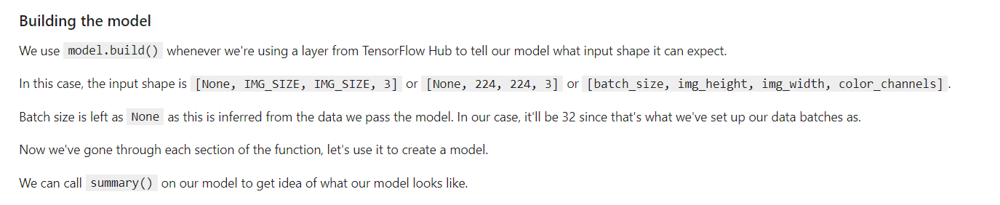

### Creating callbacks
Callbacks are helper functions a model can use during training to do such things as save its progress, check its progress or stop training early if a model stops improving.

We'll create two callbacks, one for TensorBoard which helps track our models progress and another for early stopping which prevents our model from training for too long.

### TensorBoard Callback
To setup a TensorBoard callback, we need to do 3 things:

- `Load the TensorBoard notebook extension ✅`
- `Make a new folder logs in Deep_Learning_daniel folder`
- `Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's fit() function. ✅`
- `Visualize our models training logs with the %tensorboard magic function (we'll do this after model training).`

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/TensorBoard

In [23]:
# Load TensorBoard notebook extention
%load_ext tensorboard

In [24]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("/content/drive/MyDrive/Deep_Learning_Daniel/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

________________________________

### Early Stopping Callback
Early stopping helps prevent overfitting by stopping a model when a certain evaluation metric stops improving. If a model trains for too long, it can do so well at finding patterns in a certain dataset that it's not able to use those patterns on another dataset it hasn't seen before (doesn't generalize).

It's basically like saying to our model, "keep finding patterns until the quality of those patterns starts to go down."

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping

In [25]:
# Create early stopping (once our model stops improving, stop training)
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # stops after 3 rounds of no improvements

### Training a model (on a subset of data)

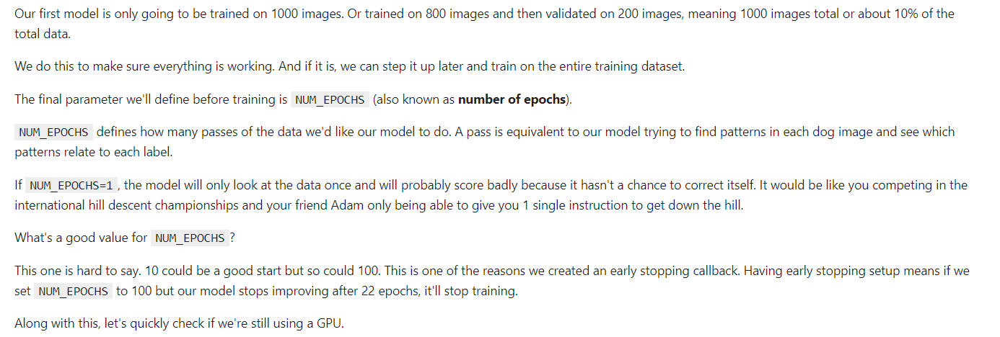

In [ ]:
# Check again if GPU is available (otherwise computing will take a looooonnnnggggg time)
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available (YESS!!!!)


In [26]:
# How many rounds should we get the model to look through the data?
NUM_EPOCHS = 100 #@param {type:'slider', min:10, max:100, step:10}

Let's create a function which trains a model.

- Create a model using `create_model()`
- Setup a TensorBoard callback using `create_tensorboard_callback()`
- Call the `fit()` function on our model passing it the training data, validation data, number of epochs to train for (NUM_EPOCHS) and the callbacks we'd like to use
Return the model

In [27]:
# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  # Return the fitted model
  return model

In [28]:
# Fit the model to the data
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
25/25 [==============================] - 101s 4s/step - loss: 4.5819 - accuracy: 0.0950 - val_loss: 3.4025 - val_accuracy: 0.2350
Epoch 2/100
25/25 [==============================] - 3s 129ms/step - loss: 1.6483 - accuracy: 0.6737 - val_loss: 2.1590 - val_accuracy: 0.4950
Epoch 3/100
25/25 [==============================] - 4s 155ms/step - loss: 0.5712 - accuracy: 0.9350 - val_loss: 1.6692 - val_accuracy: 0.5850
Epoch 4/100
25/25 [==============================] - 3s 133ms/step - loss: 0.2528 - accuracy: 0.9925 - val_loss: 1.5116 - val_accuracy: 0.6050
Epoch 5/100
25/25 [==============================] - 4s 156ms/step - loss: 0.1441 - accuracy: 1.0000 - val_loss: 1.4379 - val_accuracy: 0.6100
Epoch 6/100
25/25 [==============================] - 4s 159ms/step - loss: 0.0987 - accuracy: 1.0000 - val_loss: 1.3909 - val_accuracy: 0.6300
Epoch 7/100
25/25 [==============================]

### Overfitting in first trained model
`Question`: It looks like our model might be overfitting (getting far better results on the training set than the validation set), what are some ways to prevent model overfitting? Hint: this may involve searching something like "ways to prevent overfitting in a deep learning model?".

`Note`: Overfitting to begin with is a good thing. It means our model is learning something.

_____________________________________________

### Checking the TensorBoard logs
Now our model has been trained, we can make its performance visual by checking the `TensorBoard logs`.

The TensorBoard `magic function (%tensorboard)` will access the logs directory we created earlier and viualize its contents.

In [29]:
%tensorboard --logdir drive/MyDrive/Deep_Learning_Daniel/logs

<IPython.core.display.Javascript object>

### Making and evaluating predictions using a trained model
Before we scale up and train on more data, let's see some other ways we can evaluate our model. Because although accuracy is a pretty good indicator of how our model is doing, it would be even better if we could could see it in action.

Making predictions with a trained model is as calling `predict()` on it and passing it data in the same format the model was trained on.

In [ ]:
val_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [30]:
# MAke prediction on validation data
predictions = model.predict(val_data, verbose=1)
print(len(predictions))
predictions

7/7 [==============================] - 33s 105ms/step
200


array([[1.00971013e-03, 9.01159219e-05, 1.77886337e-04, ...,
        9.20172970e-05, 3.00467345e-05, 1.32748391e-03],
       [1.01417834e-02, 2.75987375e-04, 3.45442980e-03, ...,
        1.29015918e-03, 2.61440175e-03, 3.52188887e-04],
       [3.03679029e-04, 2.72751960e-04, 2.48937340e-05, ...,
        1.92949071e-03, 9.88763059e-04, 1.84547924e-03],
       ...,
       [3.01118416e-06, 7.93728541e-05, 3.69929621e-05, ...,
        9.41368944e-06, 2.02023366e-04, 7.05714683e-06],
       [2.94970185e-03, 6.79743534e-05, 1.28104104e-04, ...,
        9.27990550e-05, 1.00036095e-05, 1.18287606e-02],
       [1.47684419e-03, 2.85447750e-05, 3.60366073e-04, ...,
        1.62430760e-02, 1.25888828e-03, 4.19821954e-05]], dtype=float32)

In [ ]:
predictions.shape

(200, 120)

In [ ]:
len(y_val)

200

In [ ]:
# It means that in predictions every number tell us how much this number is one of our breeds
# The softmax (0 to 1)
np.sum(predictions[0])

0.9999999

In [ ]:
# First prediction
index = 77
print(predictions[index])
print(f"Max value (probability of prediction): {np.max(predictions[index])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[index])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[index])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}") # the predicted label

[1.74741307e-03 2.39714165e-04 2.78435418e-05 9.64222490e-05
 2.12593950e-05 8.81791522e-04 6.75006522e-05 3.62787905e-05
 7.78056201e-05 5.83514338e-06 1.39254480e-04 2.39124529e-05
 2.22014933e-05 7.61509364e-06 2.22533117e-06 1.62962569e-05
 4.58812901e-05 4.79516602e-05 1.97699439e-04 4.27855457e-06
 2.93982215e-04 6.46538547e-06 4.36502014e-05 1.95997782e-05
 5.47133386e-05 1.45992567e-06 1.12494163e-03 1.09390319e-04
 1.09938243e-04 2.43944436e-04 4.05728133e-05 9.66414882e-06
 2.44176499e-06 2.46405252e-05 5.08926460e-04 5.64938564e-05
 6.28193084e-05 1.12933631e-05 4.52186687e-05 1.92770312e-06
 4.29420652e-06 4.08971709e-06 1.41467649e-06 2.83323607e-05
 1.19350705e-04 1.77283728e-04 5.26739692e-04 7.27703127e-06
 8.52225203e-05 1.67984181e-04 6.96213028e-05 6.37190851e-06
 4.19362113e-05 1.20055684e-05 8.79230022e-01 2.74384656e-05
 4.74439730e-05 2.21510545e-05 1.20993194e-04 2.98947853e-05
 2.91645498e-04 3.77645338e-05 9.72083420e-04 5.65872506e-05
 2.62408226e-04 8.940233

Having this information is great but it would be even better if we could compare a prediction to its true label and original image.

To help us, let's first build a little function to convert prediction probabilities into predicted labels.

Note: Prediction probabilities are also known as confidence levels.

In [31]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities (200 valid data)
pred_label = get_pred_label(predictions[199])
pred_label

'cardigan'

In [ ]:
val_data

<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [32]:
# Create a function to unbatch a batch dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and reutrns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0]
val_labels[0]

'cairn'

Now we've got ways to get get:

- Prediction labels
- Validation labels (truth labels)
- Validation images

Let's make some function to make these all a bit more visaulize.

We'll create a function which:

- Takes an array of prediction probabilities, an array of truth - labels and an array of images and an integer. ✅
- Convert the prediction probabilities to a predicted label. ✅
- Plot the predicted label, its predicted probability, the truth label and the target image on a single plot. ✅

In [33]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  
  # Get the pred label
  pred_label = get_pred_label(pred_prob)
  
  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

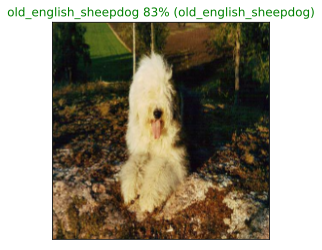

In [34]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=7)

### Nice! Making functions to help visual your models results are really helpful in understanding how your model is doing.

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making. More specifically, if our model predicts a certain label with 24% probability, what else did it predict?

Let's build a function to demonstrate. The function will:

Take an input of a prediction probabilities array, a ground truth labels array and an integer.
- Find the predicted label using get_pred_label().
- Find the top 10:
  - Prediction probabilities indexes
  - Prediction probabilities values
  - Prediction labels

Plot the top 10 prediction probability values and labels, coloring the true label green.

In [35]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

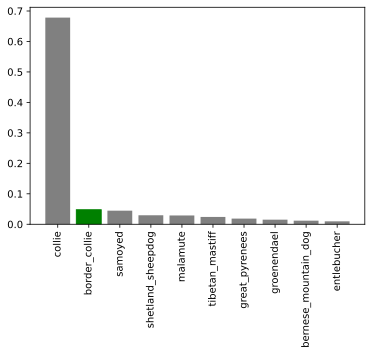

In [36]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

Now we've got some function to help us visualize our predictions and evaluate our modle, let's check out a few.

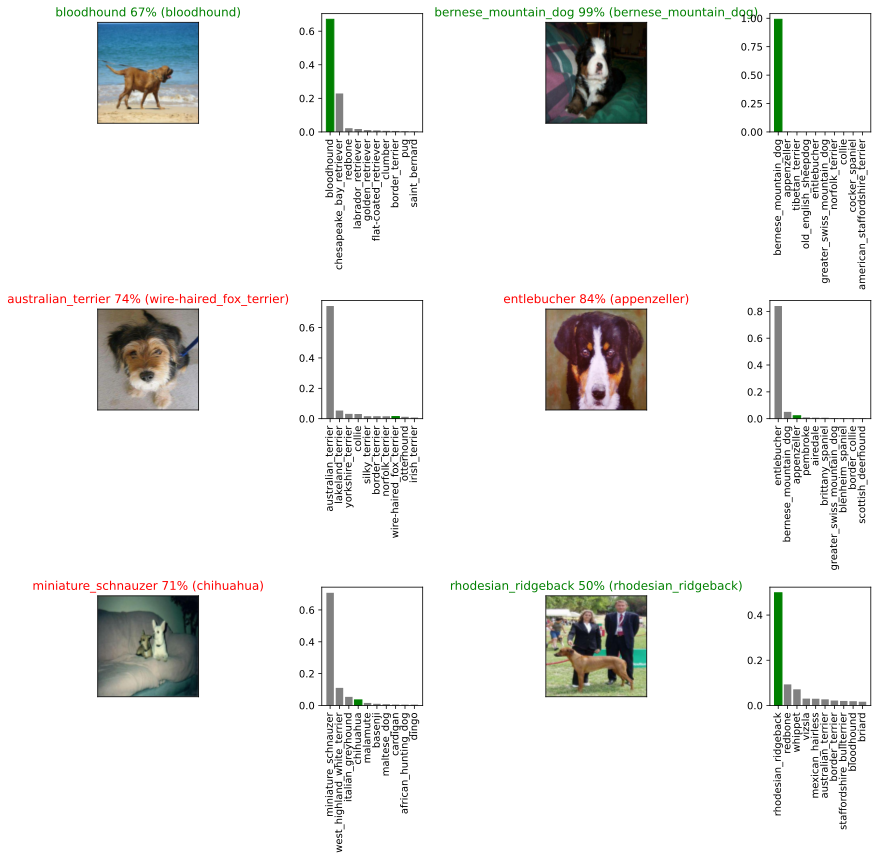

In [37]:
# Let's check a few predictions and their different values
i_multiplier = 100
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(6*num_cols, 4*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

### Saving and reloading a model
After training a model, it's a good idea to save it. Saving it means you can share it with colleagues, put it in an application and more importantly, won't have to go through the potentially expensive step of retraining it.

The format of an entire saved Keras model is h5. So we'll make a function which can take a model as input and utilise the save() method to save it as a h5 file to a specified directory.

In [46]:
# Create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (string).
  """
  # Create a model directory pathname with current time
  modeldir = os.path.join("/content/drive/MyDrive/Deep_Learning_Daniel/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [47]:
# Create a function to load a trained model
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path, 
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

Now we've got functions to save and load a trained model, let's make sure they work!

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-mobilenetv2-Adam")

Saving model to: /content/drive/MyDrive/Deep_Learning_Daniel/models/20230104-10431672829038-1000-images-mobilenetv2-Adam.h5...


'/content/drive/MyDrive/Deep_Learning_Daniel/models/20230104-10431672829038-1000-images-mobilenetv2-Adam.h5'

In [ ]:
# Load a trained model
loaded_1000_image_model = load_model('/content/drive/MyDrive/Deep_Learning_Daniel/models/20230104-10431672829038-1000-images-mobilenetv2-Adam.h5')

Loading saved model from: /content/drive/MyDrive/Deep_Learning_Daniel/models/20230104-10431672829038-1000-images-mobilenetv2-Adam.h5


In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 1s 128ms/step - loss: 1.2631 - accuracy: 0.6650


[1.2631440162658691, 0.6650000214576721]

In [ ]:
# Evaluate the loaded model
loaded_1000_image_model.evaluate(val_data)

7/7 [==============================] - 2s 134ms/step - loss: 1.2631 - accuracy: 0.6650


[1.2631440162658691, 0.6650000214576721]

### Training a model (on the full data)
Now we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to `X` and all of the training labels to `y`. 
Let's check them out.

In [39]:
# Remind ourselves of the size of the full dataset  / x nad y are our train data
len(x), len(y)

(10222, 10222)

In [40]:
# Create a data batch with the full data set
full_data = create_data_batches(x, y)
full_data

Creating training data batches...


<BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))>

In [41]:
len(full_data)

320

In [42]:
# Create a model for full model
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


In [43]:
# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()
# No validation set when training on all the data, so we can't monitor validation accuracy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [44]:
# Fit the full model to the full data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 859s 3s/step - loss: 1.3723 - accuracy: 0.6677
Epoch 2/100
320/320 [==============================] - 40s 123ms/step - loss: 0.4026 - accuracy: 0.8823
Epoch 3/100
320/320 [==============================] - 37s 116ms/step - loss: 0.2417 - accuracy: 0.9358
Epoch 4/100
320/320 [==============================] - 40s 125ms/step - loss: 0.1572 - accuracy: 0.9635
Epoch 5/100
320/320 [==============================] - 41s 129ms/step - loss: 0.1060 - accuracy: 0.9776
Epoch 6/100
320/320 [==============================] - 39s 122ms/step - loss: 0.0780 - accuracy: 0.9877
Epoch 7/100
320/320 [==============================] - 40s 124ms/step - loss: 0.0591 - accuracy: 0.9920
Epoch 8/100
320/320 [==============================] - 42s 132ms/step - loss: 0.0487 - accuracy: 0.9932
Epoch 9/100
320/320 [==============================] - 40s 124ms/step - loss: 0.0377 - accuracy: 0.9960
Epoch 10/100
320/320 [==============================] - 40s 124ms/

In [45]:
%tensorboard --logdir drive/MyDrive/Deep_Learning_Daniel/logs

Reusing TensorBoard on port 6006 (pid 4538), started 0:56:25 ago. (Use '!kill 4538' to kill it.)

<IPython.core.display.Javascript object>

In [48]:
save_model(full_model, suffix="full-image-set-mobilenetv2-Adam")

Saving model to: /content/drive/MyDrive/Deep_Learning_Daniel/models/20230105-10101672913412-full-image-set-mobilenetv2-Adam.h5...


'/content/drive/MyDrive/Deep_Learning_Daniel/models/20230105-10101672913412-full-image-set-mobilenetv2-Adam.h5'

In [49]:
loaded_full_model = load_model('/content/drive/MyDrive/Deep_Learning_Daniel/models/20230105-10101672913412-full-image-set-mobilenetv2-Adam.h5')

Loading saved model from: /content/drive/MyDrive/Deep_Learning_Daniel/models/20230105-10101672913412-full-image-set-mobilenetv2-Adam.h5


## Making predictions on the test dataset
Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

Luckily we created `create_data_batches()` earlier which can take a list of filenames as input and conver them into Tensor batches.

To make predictions on the test data, we'll:

- Get the test image filenames. ✅
- Convert the filenames into test data batches using create_data_batches() and setting the test_data parameter to True (since the test data doesn't have labels). ✅
- Make a predictions array by passing the test batches to the predict() method called on our model.

In [50]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "/content/drive/MyDrive/Deep_Learning_Daniel/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['/content/drive/MyDrive/Deep_Learning_Daniel/test/e50319e7efc447bb684fbfdbed3ff041.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/test/dccc6c6c2f8cb55631b6ce664bf21fee.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/test/dd8c716a81edb1cac3d4cb2b6c47880a.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/test/e7dc8cc599049ea9fa2a172c88646c57.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/test/ddbdd621e79563a56443a0dd1ee4c48d.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/test/e380bd4f8375d09ae72f4f36aa610031.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/test/e440ec011c3c7ea94838ab5fc466159c.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/test/e7afb35b8252782013a6700e28e327fa.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/test/dcc047e682db75bbcebdec2288192f1d.jpg',
 '/content/drive/MyDrive/Deep_Learning_Daniel/test/e366960ee7583d7ffd22783085b53e5d.jpg']

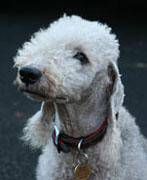

In [52]:
Image(filename=test_filenames[7])

In [53]:
# How many test images are there? So we had 10222 train images and we want to predict 9478 images.
len(test_filenames)

9478

In [54]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [55]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

297/297 [==============================] - 877s 3s/step


In [57]:
test_predictions[10]

array([3.54638323e-05, 1.41139921e-07, 2.25070274e-08, 2.18912085e-12,
       3.99750170e-05, 3.83433107e-09, 2.25178701e-06, 7.39689267e-06,
       4.55631941e-08, 2.55969468e-07, 4.08136920e-08, 4.34840643e-07,
       2.00571382e-09, 2.66236589e-06, 3.60875829e-10, 2.60092889e-07,
       4.73810530e-07, 2.01182200e-08, 1.17281914e-07, 3.20531427e-07,
       8.07205680e-09, 1.46622335e-06, 3.99494439e-07, 3.94069583e-10,
       6.43494573e-08, 8.28362309e-11, 5.27954171e-07, 7.40041378e-06,
       9.92491311e-10, 2.62088346e-04, 1.37803781e-05, 4.94644439e-07,
       5.59225509e-06, 2.17024336e-07, 5.90847060e-09, 5.44799192e-08,
       6.96719766e-08, 4.04086613e-08, 3.46161211e-09, 6.91415813e-10,
       4.55528294e-07, 1.12690013e-05, 4.35874492e-09, 1.55432735e-05,
       1.28053879e-09, 1.41478929e-04, 3.34899525e-10, 2.22740959e-09,
       8.30585600e-10, 5.46662378e-08, 1.42215640e-06, 7.90663446e-09,
       2.93422618e-05, 6.75613137e-06, 1.88755521e-07, 2.64461249e-07,
      

In [58]:
# Save predictions (NumPy array) to csv file (for access later)
# np.savetxt("/content/drive/MyDrive/Deep_Learning_Daniel/preds_array.csv", test_predictions, delimiter=",")

In [59]:
# Load predictions (NumPy array) from csv file
test_predictions = np.loadtxt("/content/drive/MyDrive/Deep_Learning_Daniel/preds_array.csv", delimiter=",")

In [60]:
test_predictions.shape

(9478, 120)

### Preparing test dataset predictions for Kaggle
Looking at the `Kaggle sample submission`, it looks like they want the models output probabilities each for label along with the image ID's.

To get the data in this format, we'll:

- Create a pandas DataFrame with an ID column as well as a column for each dog breed.
- Add data to the ID column by extracting the test image ID's from their filepaths.
- Add data (the prediction probabilities) to each of the dog breed columns using the unique_breeds list and the test_predictions list.
- Export the DataFrame as a CSV to submit it to Kaggle.

In [61]:
# Create a pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [62]:
# Append test image ID's to predictions DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df["id"] = test_ids
preds_df.id[:5]

0    e50319e7efc447bb684fbfdbed3ff041
1    dccc6c6c2f8cb55631b6ce664bf21fee
2    dd8c716a81edb1cac3d4cb2b6c47880a
3    e7dc8cc599049ea9fa2a172c88646c57
4    ddbdd621e79563a56443a0dd1ee4c48d
Name: id, dtype: object

In [63]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,e50319e7efc447bb684fbfdbed3ff041,1.544069e-09,1.460932e-10,9.475666e-09,6.076054e-06,3.054782e-05,2.306814e-01,6.298375e-08,1.165006e-05,1.321670e-08,...,7.149367e-08,8.593709e-10,1.894654e-08,6.307813e-08,1.671688e-08,1.239459e-05,4.095812e-09,3.913250e-08,6.335767e-07,5.445696e-09
1,dccc6c6c2f8cb55631b6ce664bf21fee,2.084661e-09,1.233974e-12,6.104047e-14,1.934605e-09,5.307553e-09,3.505827e-07,3.477153e-10,6.525546e-10,2.564565e-11,...,3.842368e-09,1.975987e-07,1.009588e-07,6.534573e-11,4.814397e-11,5.338844e-09,1.031312e-11,2.733400e-10,3.056004e-12,1.859518e-10
2,dd8c716a81edb1cac3d4cb2b6c47880a,1.626054e-10,4.992214e-10,2.248111e-11,1.143310e-06,2.666589e-11,7.391677e-10,6.797120e-12,5.263198e-12,9.950745e-10,...,7.015188e-11,3.252113e-12,1.807582e-09,5.088840e-07,1.211759e-08,1.820664e-10,2.519053e-11,1.312865e-09,8.646808e-10,4.684276e-12
3,e7dc8cc599049ea9fa2a172c88646c57,1.023105e-06,1.772710e-08,9.947342e-09,7.423884e-10,1.763649e-07,1.987357e-08,1.223182e-09,8.354387e-09,6.013223e-11,...,2.782559e-07,1.937968e-08,6.105128e-09,1.276431e-08,1.426378e-08,6.868921e-09,5.989505e-07,4.314138e-10,4.699401e-07,1.945359e-07
4,ddbdd621e79563a56443a0dd1ee4c48d,1.344905e-06,1.323727e-08,1.472196e-09,1.098053e-07,1.286554e-08,4.711524e-08,1.004543e-07,8.045200e-09,5.578118e-09,...,1.021194e-07,1.299863e-09,2.522502e-09,8.883040e-08,6.563772e-07,2.967909e-11,9.754115e-09,6.496175e-10,4.114662e-09,3.819574e-10


In [64]:
# Save our predictions dataframe to CSV for submission to Kaggle
preds_df.to_csv("/content/drive/MyDrive/Deep_Learning_Daniel/full_model_predictions_submission_1_mobilenetV2.csv",
                index=False)

### Making predictions on custom images
To make predictions on custom images, we'll:

- Get the filepaths of our own images.
- Turn the filepaths into data batches using create_data_batches(). And since our custom images won't have labels, we set the test_data parameter to True.
- Pass the custom image data batch to our model's predict() method.
- Convert the prediction output probabilities to predictions labels.
- Compare the predicted labels to the custom images.

In [66]:
# Get custom image filepaths
custom_path = "/content/drive/MyDrive/Deep_Learning_Daniel/custom_test_images/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]
len(custom_image_paths)

3

In [67]:
# Turn custom image into batch (set to test data because there are no labels)
custom_data = create_data_batches(custom_image_paths, test_data=True)

Creating test data batches...


In [68]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

1/1 [==============================] - 1s 1s/step


In [69]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['eskimo_dog', 'german_shepherd', 'pomeranian']

In [70]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

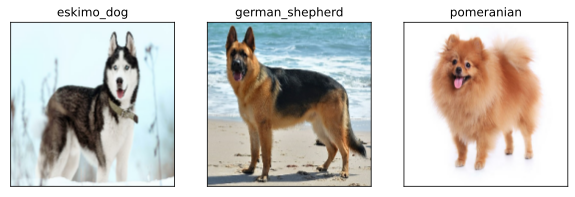

In [71]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)